In [156]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score, train_test_split, GridSearchCV
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import r2_score
from sklearn.preprocessing import MaxAbsScaler
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder

In [157]:
#Mount the drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [158]:
#Get the data
airbnb = pd.read_csv("/content/drive/Shareddrives/Ensemble Learning/Airbnb project/data_NYC_2019.csv")

#EDA

In [159]:
airbnb.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [160]:
airbnb.shape

(48895, 16)

In [161]:
airbnb.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,1.901714e+07,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,1.098311e+07,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,2.539000e+03,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,9.471945e+06,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,1.967728e+07,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,2.915218e+07,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,3.648724e+07,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [162]:
#Explore null values
airbnb.isnull().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

So we have 10052 listing with no last_review or reviews_per_month. Those can probably be new listings in the platform (we can create a binary column for this)

In [163]:
#Just checking for the case where there is null in last review but not in reviews per month
airbnb['reviews_per_month'][airbnb['last_review'].isnull()].isnull().sum()

10052

#### Feel NA's appropriately

In [164]:
# Fill string columns' na with unknown
airbnb['name'].fillna('unknown',inplace=True)
airbnb['host_name'].fillna('unknown',inplace=True)

# Fill numerical columns' na with the mean
airbnb['reviews_per_month'].fillna(airbnb['reviews_per_month'].mean(),inplace=True)
'''not filling last_review yet to use it for feature engineering'''

airbnb.isnull().sum()

id                                    0
name                                  0
host_id                               0
host_name                             0
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                     0
calculated_host_listings_count        0
availability_365                      0
dtype: int64

id


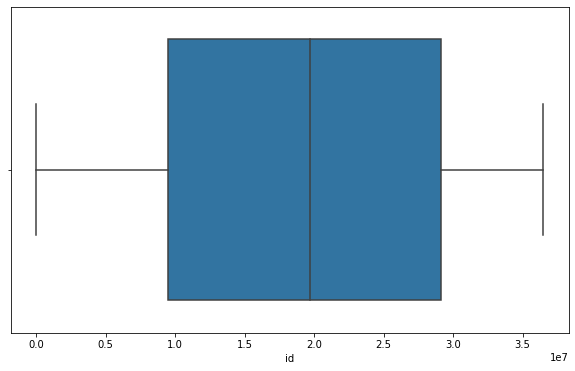

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


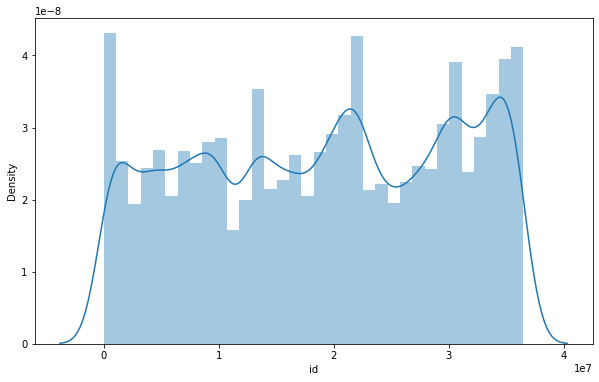

host_id


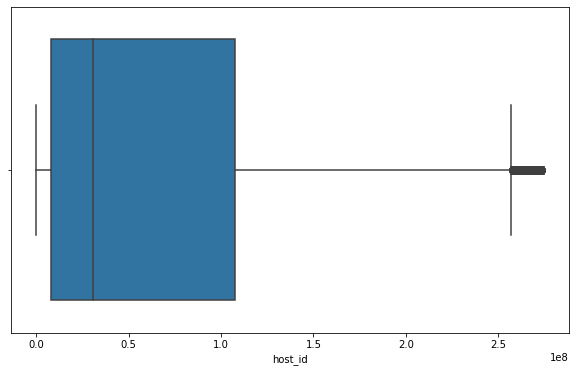

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


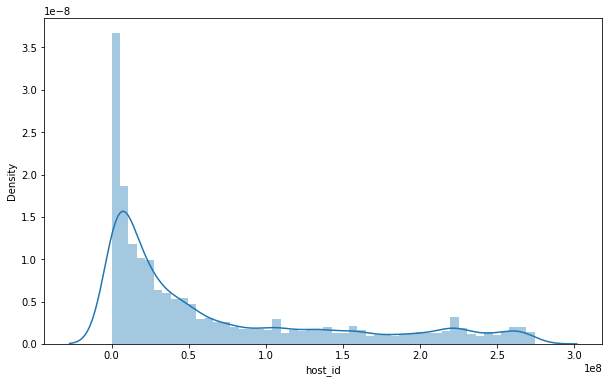

latitude


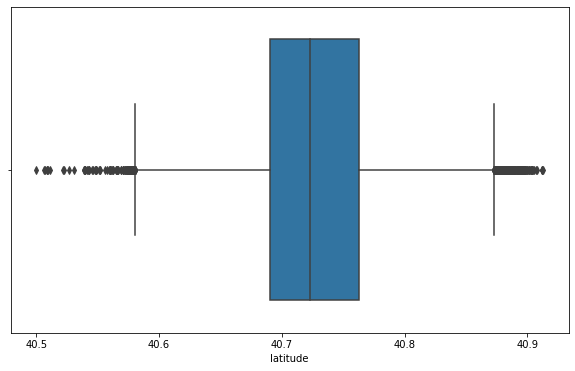

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


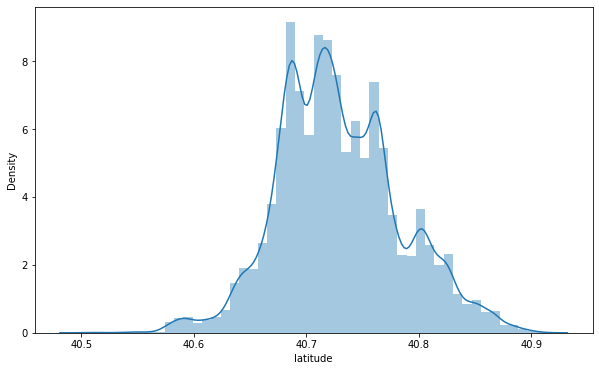

longitude


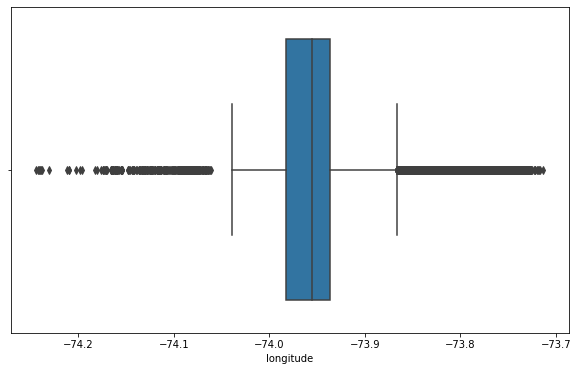

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


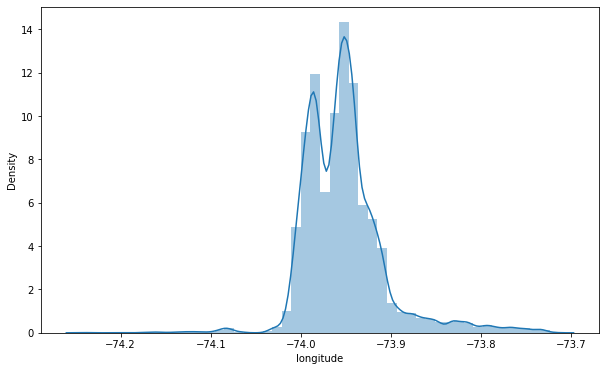

price


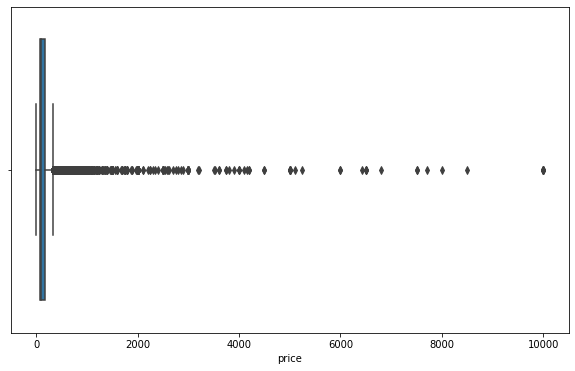

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


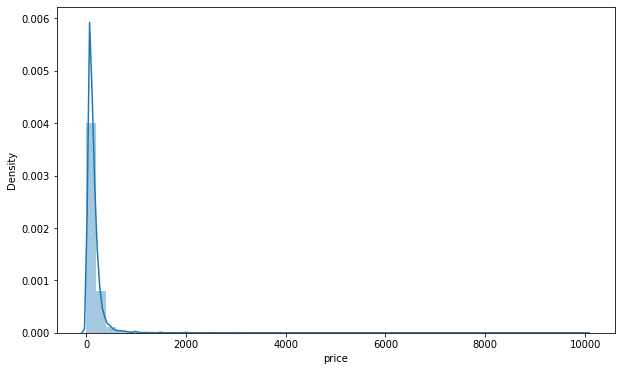

minimum_nights


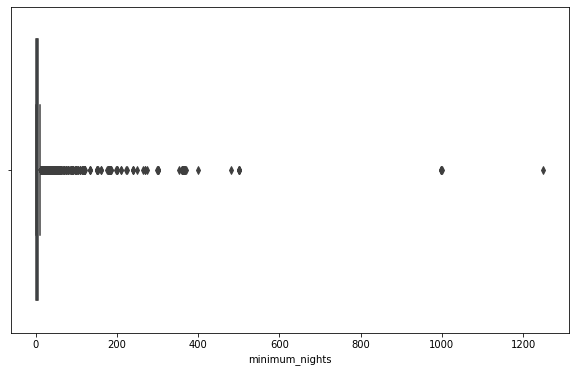

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


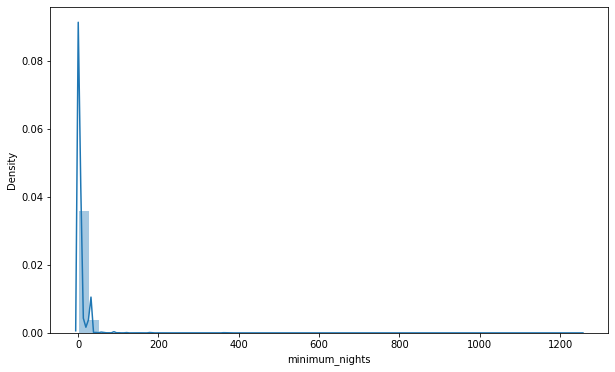

number_of_reviews


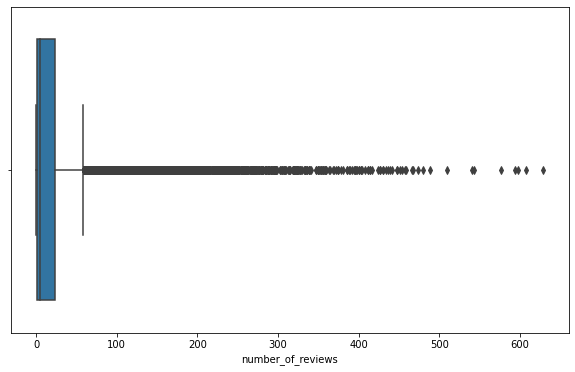

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


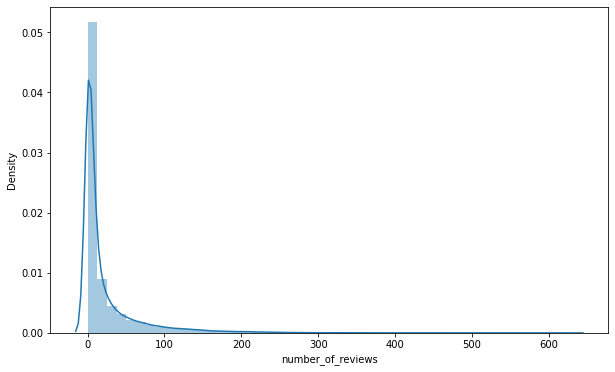

reviews_per_month


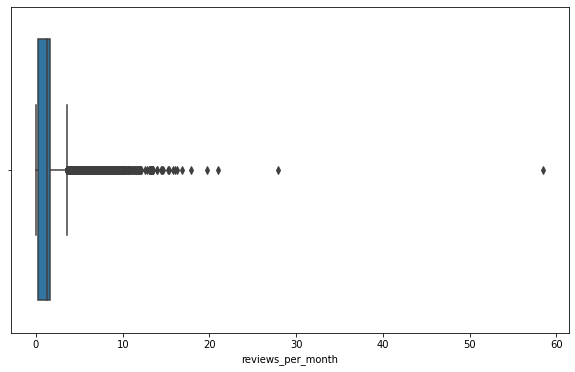

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


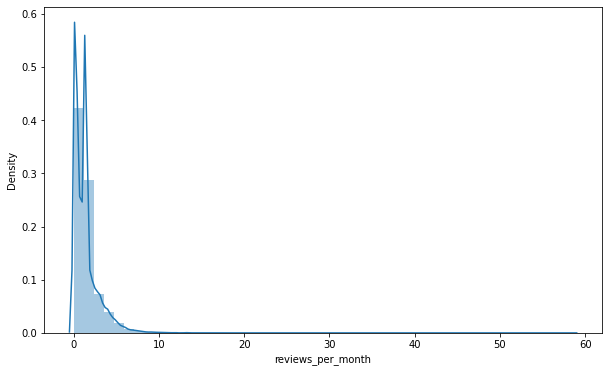

calculated_host_listings_count


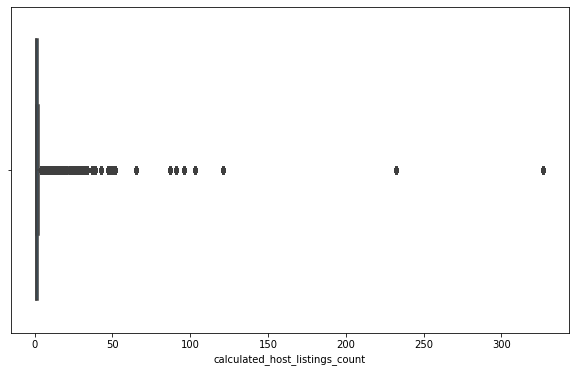

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


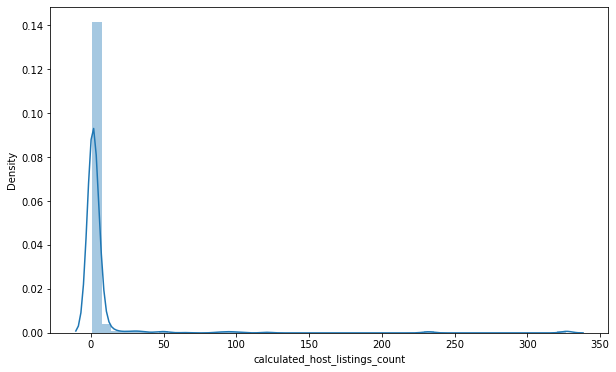

availability_365


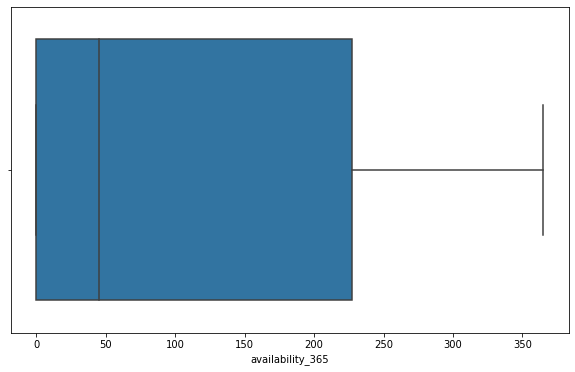

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


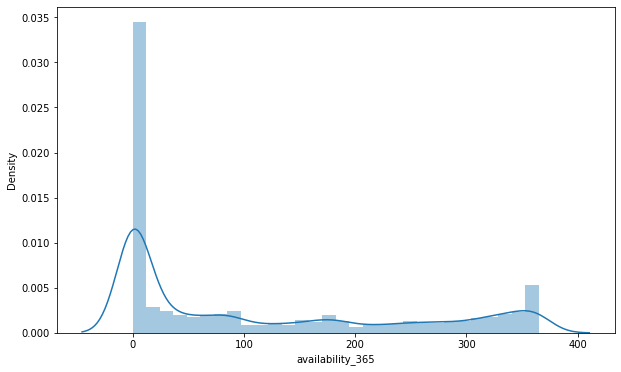

In [165]:
#Distribution of columns
numerical_cols = airbnb.select_dtypes(include=['int', 'float']).columns.tolist()

# Create boxplots for each numerical column
for col in numerical_cols:
  fig = plt.figure(figsize=(10, 6))
  print(col)
  #Boxplot
  sns.boxplot(data=airbnb, x=col)
  plt.show()

  #Distplot
  fig = plt.figure(figsize=(10, 6))
  sns.distplot(airbnb[col])
  plt.show()

We clearly have a lot of outliers

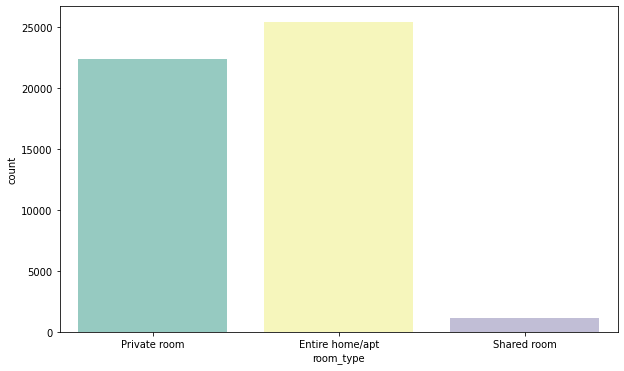

In [166]:
# Distribution of room_type
fig = plt.figure(figsize=(10, 6))
sns.countplot(data=airbnb, x="room_type", palette='Set3')
plt.show()

So we have 3 different room types with shared room being quite underrepresented in the data.

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


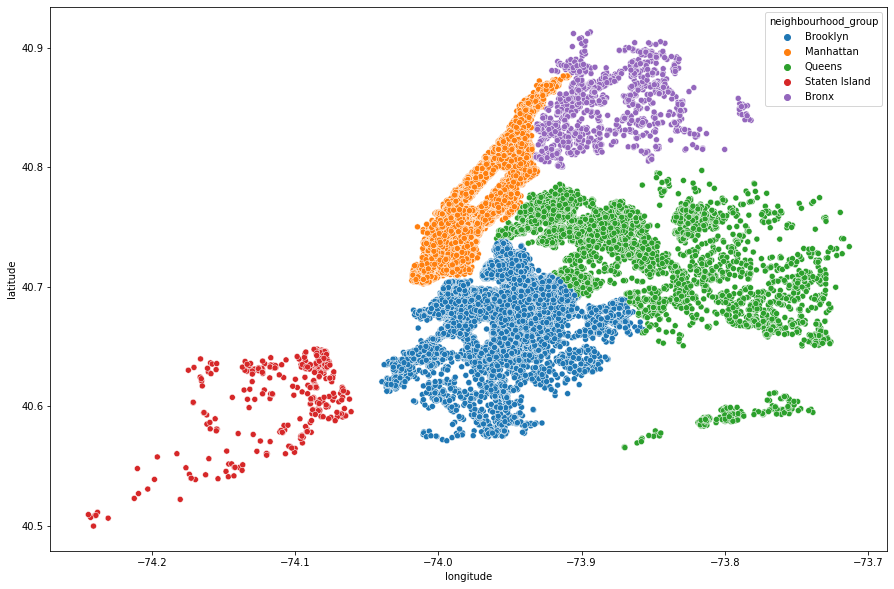

In [167]:
# map of neighbourhood group
plt.figure(figsize=(15,10))
sns.scatterplot(airbnb.longitude,airbnb.latitude,hue=airbnb.neighbourhood_group)
plt.ioff()

Insights:

Not too many new listings on the Staten Island

Most new listing on Manhattan and Centre of Brooklyn (maybe worth differenciating between centre and non-centre)

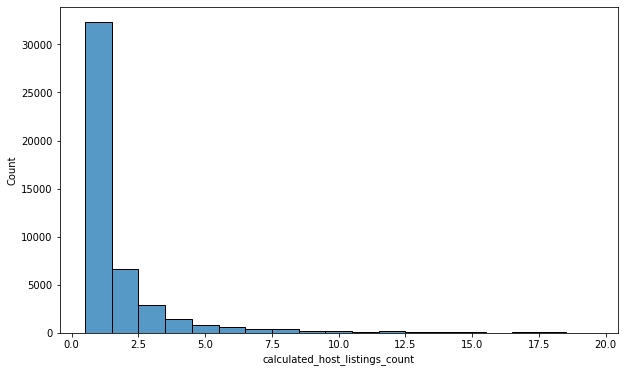

In [168]:
#Distribution of calculated_host_listings_count
#Distplot
fig = plt.figure(figsize=(10, 6))
sns.histplot(airbnb["calculated_host_listings_count"][airbnb.calculated_host_listings_count<20], discrete=True)
plt.show()

In [169]:
airbnb.calculated_host_listings_count.value_counts()

1      32303
2       6658
3       2853
4       1440
5        845
6        570
8        416
7        399
327      327
9        234
232      232
10       210
96       192
12       180
13       130
121      121
11       110
52       104
103      103
33        99
49        98
91        91
87        87
15        75
14        70
23        69
34        68
17        68
65        65
31        62
28        56
18        54
25        50
50        50
47        47
43        43
20        40
39        39
37        37
32        32
30        30
29        29
27        27
26        26
21        21
19        19
16        16
Name: calculated_host_listings_count, dtype: int64

Wherever they match it means that there is only one person having that many listings

/usr/local/lib/python3.8/dist-packages/pandas/core/arraylike.py:364: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


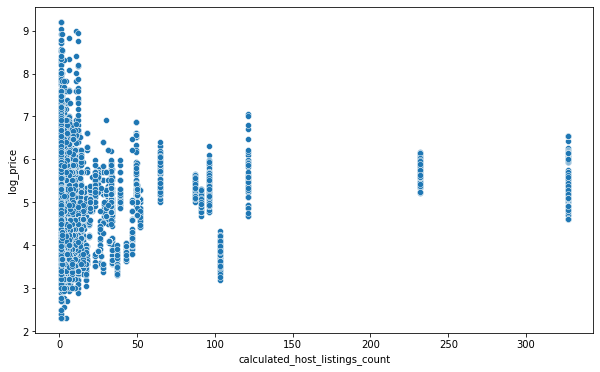

In [170]:
fig = plt.figure(figsize=(10, 6))
temp = airbnb.copy()
temp['log_price'] = np.log(temp['price'])
sns.scatterplot(data=temp, x='calculated_host_listings_count', y='log_price')
plt.show()

The price varies more for hosts having less listings. Maybe not helpful since there are more hosts with less listings in general

<AxesSubplot:>

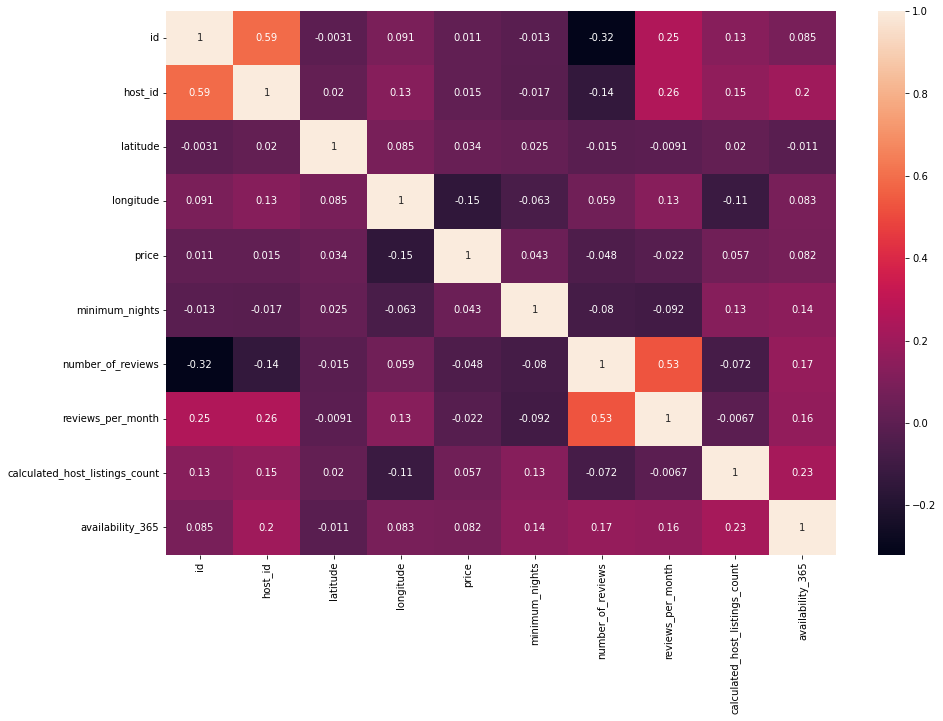

In [171]:
# Correlation man
corr = airbnb.corr()
plt.figure(figsize=(15,10))
sns.heatmap(corr, annot=True)

In [172]:
print('In this dataset there are {} unique hosts renting out a total number of {} properties.'.format(len(airbnb['host_id'].unique()), airbnb.shape[0]))

In this dataset there are 37457 unique hosts renting out a total number of 48895 properties.


#### Room type

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0.5, 1.0, 'Neighbourhood Group')

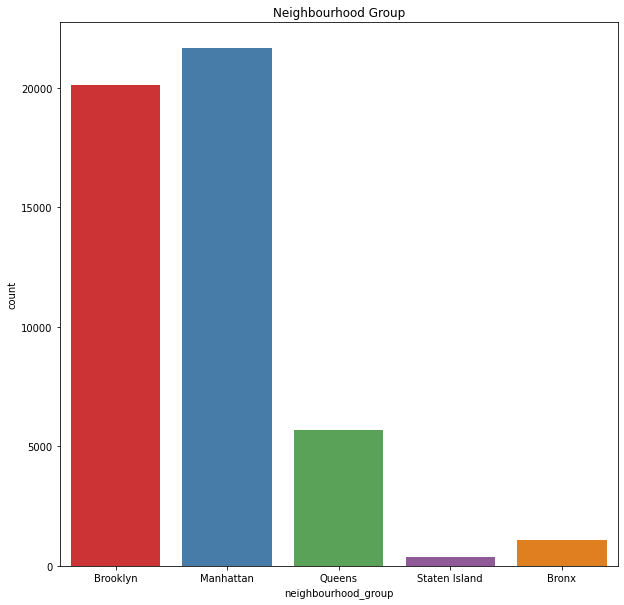

In [173]:
# The entries in the "neighbourhood_group"
sns.countplot(airbnb['neighbourhood_group'], palette = 'Set1')
fig = plt.gcf()
fig.set_size_inches(10,10)
plt.title('Neighbourhood Group')

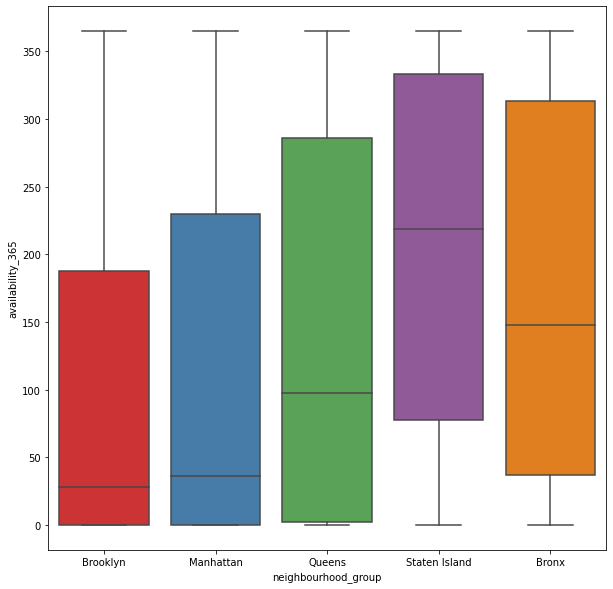

In [174]:
# Relation between neighbourgroup and Availability of Room
plt.figure(figsize=(10,10))
ax = sns.boxplot(data=airbnb, x='neighbourhood_group',y='availability_365',palette='Set1')

Significantly higher availability in Staten Island, significantly low in Brooklyn and Manhattan

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


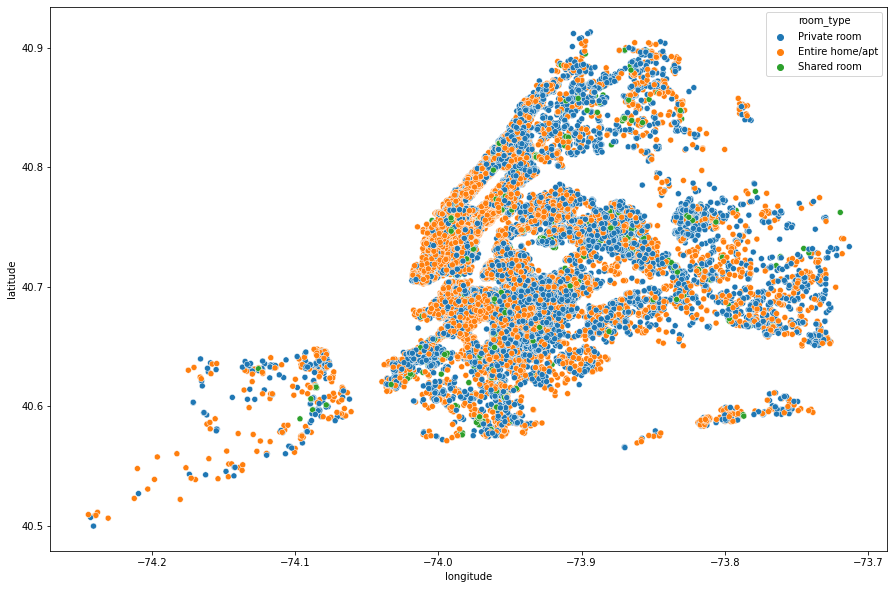

In [175]:
# map of the room type
plt.figure(figsize=(15,10))
sns.scatterplot(airbnb.longitude,airbnb.latitude,hue=airbnb.room_type)
plt.ioff()

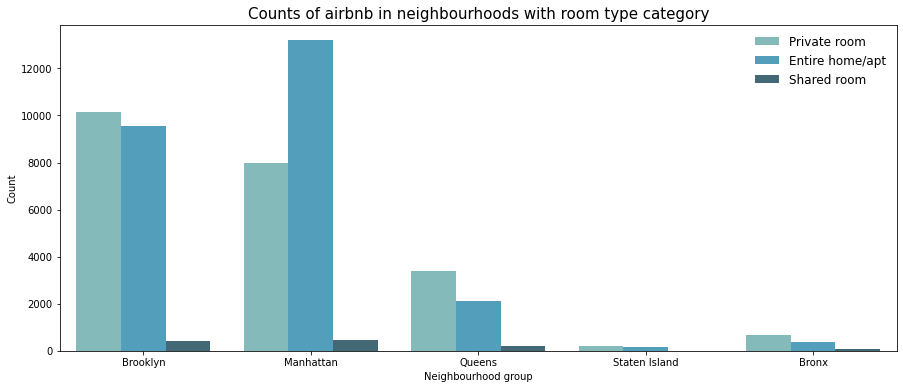

In [176]:
# Neighbourhood groups with counts with category room_type

plt.figure(figsize=(15,6))
sns.countplot(data=airbnb, x='neighbourhood_group', hue='room_type', palette='GnBu_d')
plt.title('Counts of airbnb in neighbourhoods with room type category', fontsize=15)
plt.xlabel('Neighbourhood group')
plt.ylabel("Count")
plt.legend(frameon=False, fontsize=12)

Text(0, 0.5, 'Price')

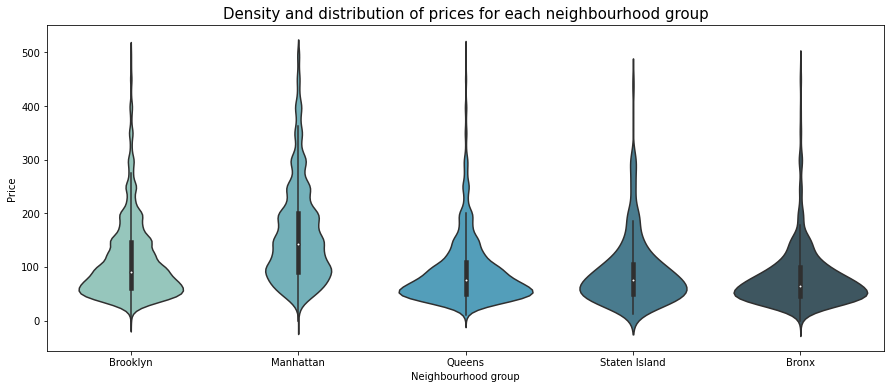

In [177]:
# Distribution of prices for each neighboorhood group
plt.figure(figsize=(15,6))
sns.violinplot(data=airbnb[airbnb.price <500], x='neighbourhood_group', y='price', palette='GnBu_d') #<500 to get rid of outliers
plt.title('Density and distribution of prices for each neighbourhood group', fontsize=15)
plt.xlabel('Neighbourhood group')
plt.ylabel("Price")

# Feature engineering

In [178]:
#Creating that binary column (new listing : Yes/No)
airbnb["new_listing"] = 0
airbnb["new_listing"][airbnb["last_review"].isnull()] = 1

#Now fill NA
airbnb['last_review'].fillna(0,inplace=True)

<ipython-input-178-ef401cc4d48f>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  airbnb["new_listing"][airbnb["last_review"].isnull()] = 1


In [179]:
print("We have", airbnb["new_listing"].sum(), "new listings") # This should sum up to 10052 to be correct

We have 10052 new listings


In [180]:
#THIS TAKES A BIT LONG TO RUN
import folium

# Create a folium map centered at the average latitude and longitude of your data
mean_lat = airbnb['latitude'].mean()
mean_lon = airbnb['longitude'].mean()
map_osm = folium.Map(location=[mean_lat, mean_lon], zoom_start=11)

# Plot the data on the map and color new listings differently
for lat, lon, new in zip(airbnb['latitude'].values, airbnb['longitude'].values, airbnb['new_listing'].values):
    if new == 1: #So new listings are the ones colored in red
        color = 'red'
    else:
        color = 'lightblue'
    folium.CircleMarker(
        location=[lat, lon],
        radius=5,
        color=color,
        fill=True,
        fill_color=color,
    ).add_to(map_osm)

# Show the map
map_osm

In [181]:
# What is the average price of new listings vs old ones
mean_price_new = airbnb.price[airbnb.new_listing==1].mean()
mean_price_old = airbnb.price[airbnb.new_listing==0].mean()
print('Mean price of old listings', mean_price_old)
print('Mean price of new listings', mean_price_new)

Mean price of old listings 142.317946605566
Mean price of new listings 192.9190210903303


#### Question now is, is this difference significant? We can do a hypothesis test

Idea: Make a map and this time the reds are going to be the price outliers! So maybe we can see if an area is more expensive, or less

In [182]:
# Cast the last_review column to datetime
airbnb['last_review'] = pd.to_datetime(airbnb['last_review'])
airbnb.dtypes

id                                         int64
name                                      object
host_id                                    int64
host_name                                 object
neighbourhood_group                       object
neighbourhood                             object
latitude                                 float64
longitude                                float64
room_type                                 object
price                                      int64
minimum_nights                             int64
number_of_reviews                          int64
last_review                       datetime64[ns]
reviews_per_month                        float64
calculated_host_listings_count             int64
availability_365                           int64
new_listing                                int64
dtype: object

In [183]:
# Create a column days since last review
airbnb['review_recency'] = (airbnb.last_review.max() - airbnb.last_review).dt.days

# Get variables prepared for modelling

In [184]:
# Encoding categorical variables
airbnb['neighbourhood_group']= airbnb['neighbourhood_group'].astype("category").cat.codes
airbnb['neighbourhood'] = airbnb['neighbourhood'].astype("category").cat.codes
airbnb['room_type'] = airbnb['room_type'].astype("category").cat.codes
airbnb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   id                              48895 non-null  int64         
 1   name                            48895 non-null  object        
 2   host_id                         48895 non-null  int64         
 3   host_name                       48895 non-null  object        
 4   neighbourhood_group             48895 non-null  int8          
 5   neighbourhood                   48895 non-null  int16         
 6   latitude                        48895 non-null  float64       
 7   longitude                       48895 non-null  float64       
 8   room_type                       48895 non-null  int8          
 9   price                           48895 non-null  int64         
 10  minimum_nights                  48895 non-null  int64         
 11  nu

In [185]:
airbnb.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,new_listing,review_recency
0,2539,Clean & quiet apt home by the park,2787,John,1,108,40.64749,-73.97237,1,149,1,9,2018-10-19,0.210000,6,365,0,262
1,2595,Skylit Midtown Castle,2845,Jennifer,2,127,40.75362,-73.98377,0,225,1,45,2019-05-21,0.380000,2,355,0,48
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,2,94,40.80902,-73.94190,1,150,3,0,1970-01-01,1.373221,1,365,1,18085
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,1,41,40.68514,-73.95976,0,89,1,270,2019-07-05,4.640000,1,194,0,3
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,2,61,40.79851,-73.94399,0,80,10,9,2018-11-19,0.100000,1,0,0,231


In [186]:
# Getting rid of unimportant columns
airbnb.drop(columns=['id','name','host_id','host_name', 'last_review'],inplace=True)
airbnb.head()

,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,new_listing,review_recency
0,1,108,40.64749,-73.97237,1,149,1,9,0.210000,6,365,0,262
1,2,127,40.75362,-73.98377,0,225,1,45,0.380000,2,355,0,48
2,2,94,40.80902,-73.94190,1,150,3,0,1.373221,1,365,1,18085
3,1,41,40.68514,-73.95976,0,89,1,270,4.640000,1,194,0,3
4,2,61,40.79851,-73.94399,0,80,10,9,0.100000,1,0,0,231


In [187]:
airbnb.dtypes

neighbourhood_group                  int8
neighbourhood                       int16
latitude                          float64
longitude                         float64
room_type                            int8
price                               int64
minimum_nights                      int64
number_of_reviews                   int64
reviews_per_month                 float64
calculated_host_listings_count      int64
availability_365                    int64
new_listing                         int64
review_recency                      int64
dtype: object

In [191]:
X = airbnb.drop(['price'], axis=1)

#We will transform to logarithm and predict that
y = np.log(airbnb['price']+1)

In [189]:
#Normalize the data
scaler = StandardScaler()
X = scaler.fit_transform(X)

''' ANOTHER SCALER TO POTENTIALLY BE USED
# Initialize MaxAbsScaler
scaler = MaxAbsScaler()
'''

' ANOTHER SCALER TO POTENTIALLY BE USED\n# Initialize MaxAbsScaler\nscaler = MaxAbsScaler()\n'

In [192]:
#Preparing a Decision Tree Regression

#Perform a split
X_train, X_test, y_train, y_test = train_test_split(X , y, test_size=0.3, random_state=42)

#Initialize model
DTree = DecisionTreeRegressor(random_state=1234)

# define the hyperparameters to tune
param_grid = {
    'max_depth': [1, 2, 4, 6, 8, 10],
    'min_samples_split': [1, 2, 4, 6, 8, 10],
    'min_samples_leaf': [0.0001, 1, 2, 3, 4, 5]
}

# perform grid search with 5-fold cross validation
grid_search = GridSearchCV(DTree, param_grid, cv=5, scoring='r2', verbose=2)

grid_search.fit(X_train, y_train)

# print the best parameters found by grid search
print(grid_search.best_params_)
print('Best score:', grid_search.best_score_)

# use the best estimator to make predictions on test set
y_pred = grid_search.predict(X_test)

# evaluate the model using r2 score
print('R2 score:', r2_score(y_test, y_pred))
mse = mean_squared_error(np.exp(y_test), np.exp(y_pred)) #Transform back to original price
rmse = np.sqrt(mse)
print("RMSE:", rmse)

Fitting 5 folds for each of 216 candidates, totalling 1080 fits
[CV] END max_depth=1, min_samples_leaf=0.0001, min_samples_split=1; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=0.0001, min_samples_split=1; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=0.0001, min_samples_split=1; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=0.0001, min_samples_split=1; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=0.0001, min_samples_split=1; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=0.0001, min_samples_split=2; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=0.0001, min_samples_split=2; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=0.0001, min_samples_split=2; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=0.0001, min_samples_split=2; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=0.0001, min_samples_split=2; total time=   0.0s
[CV] END max_depth=1, min_samples_leaf=0.0001, min_samples_split=4

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:ylabel='Density'>

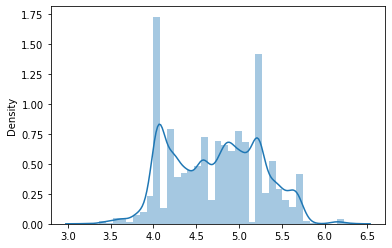

In [193]:
# Check distribution of predictions (this is the log)
#Get rid of outlliers first
# calculate z-scores
z_scores = np.abs((y_pred - np.mean(y_pred)) / np.std(y_pred))

# set threshold for outliers
threshold = 3

# drop outliers
arr = y_pred[z_scores < threshold]

sns.distplot(arr)

In [195]:
print(len(y_pred))
print(len(arr))

14669
14594


/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:ylabel='Density'>

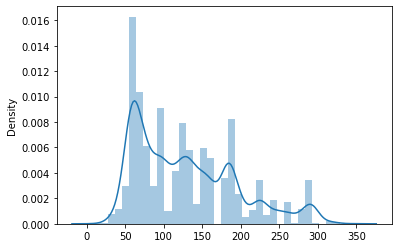

In [194]:
# Check distribution of predictions (this is the original)
#Get rid of outlliers first
# calculate z-scores
y_pred_exp = np.exp(y_pred)
z_scores = np.abs((y_pred_exp - np.mean(y_pred_exp)) / np.std(y_pred_exp))

# set threshold for outliers
threshold = 3

# drop outliers
arr_exp = y_pred_exp[z_scores < threshold]

sns.distplot(arr)

In [196]:
print(len(y_pred_exp))
print(len(arr_exp))

14669
14594


Text(0, 0.5, 'Test')

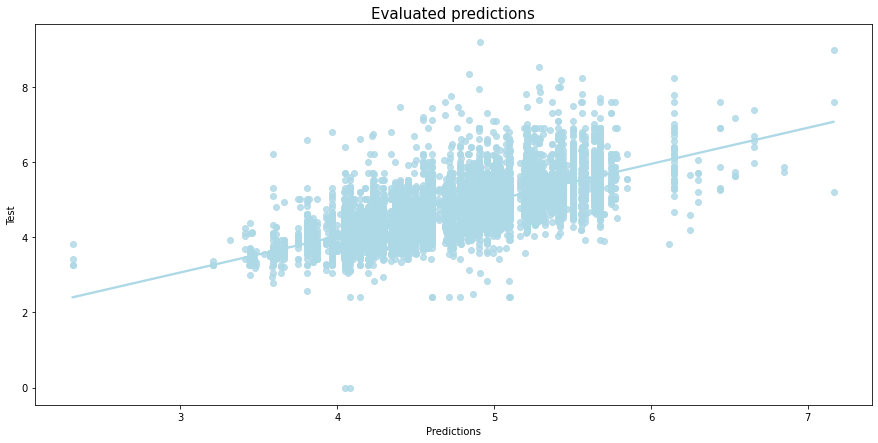

In [198]:
# Evaluate predictions graphically (this is the log)
plt.figure(figsize=(15,7))
sns.regplot(y=y_test, x=y_pred, color='lightblue')
plt.title('Evaluated predictions', fontsize=15)
plt.xlabel('Predictions')
plt.ylabel('Test')

Text(0, 0.5, 'Test')

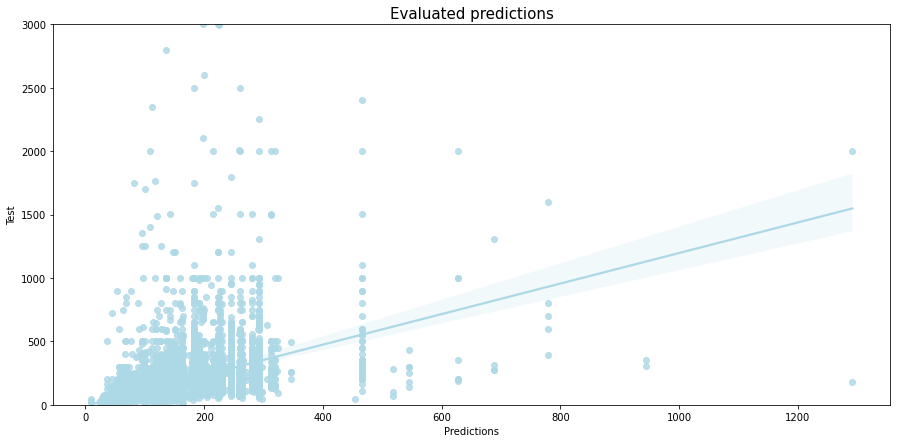

In [202]:
# Evaluate predictions graphically (this is the original)
plt.figure(figsize=(15,7))
plt.ylim(0,3000)
sns.regplot(y=np.exp(y_test), x=y_pred_exp, color='lightblue')
plt.title('Evaluated predictions', fontsize=15)
plt.xlabel('Predictions')
plt.ylabel('Test')